# **Ghibli AI Art: Trend & Engagement Analysis**

This notebook explores the recent global rise in popularity of "Ghibli AI Art" by analyzing both Google Search Trends and Reddit engagement data.

We aim to understand:
- When and how interest in Ghibli AI Art spiked globally.
- Which countries showed the highest search interest.
- What kind of engagement and sentiment it triggered on Reddit.

The analysis is divided into three parts:
1. **Google Search Trends Analysis** – Explore search interest over time and identify the viral moment.
2. **Regional Interest Comparison** – Identify countries with the highest Ghibli AI-related search volume.
3. **Reddit Engagement & Sentiment Analysis** – Examine top posts, user sentiment, and daily discussion patterns.

By combining search behavior and social media responses, this notebook provides a comprehensive view of how the Ghibli AI trend unfolded online.

---

# Part 1: Google Search Trends Analysis over time

This notebook analyzes the global virality of AI-generated art in the style of Studio Ghibli. It combines Google Trends data and Reddit post activity to identify when and where interest in "Ghibli AI Art" spiked.

We use three key search terms:
- **Ghibli AI Art**
- **Studio Ghibli AI Art**
- **Midjourney Ghibli**

In this first part, we import the necessary libraries and preview the dataset `ghibli_interest_by_time.csv`, which contains daily worldwide search interest values from January 13 to April 13, 2025.

The data includes:
- `Day`: The date of the interest measurement
- `Ghibli AI Art (Worldwide)`
- `Studio Ghibli AI Art (Worldwide)`
- `Midjourney Ghibli (Worldwide)`

Each value represents a normalized interest score from Google Trends, where 100 indicates peak popularity for that keyword on a given day.

### Data Import and Initial Exploration

We begin the analysis by importing the required libraries and loading the Google Trends dataset related to "Ghibli AI Art", "Studio Ghibli AI Art", and "Midjourney Ghibli".

The dataset `ghibli_interest_by_time.csv` contains daily worldwide search interest values for each of these keywords. The interest values are scaled between 0 and 100, where 100 represents peak popularity on a given day.

Below, we display the first few rows of the dataset to understand its structure and confirm that it has loaded correctly.


In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import plotly.express as px

In [2]:
df = pd.read_csv("ghibli_interest_by_time.csv", skiprows=1)
df.head()

,Day,Ghibli AI Art: (Worldwide),Studio Ghibli AI Art: (Worldwide),Midjourney Ghibli: (Worldwide)
0,2025-01-13,0,0,0
1,2025-01-14,0,0,0
2,2025-01-15,0,0,0
3,2025-01-16,0,0,0
4,2025-01-17,0,0,0


### Data Cleaning and Preparation

To simplify further analysis, we rename key columns for easier access. Specifically, the `Day` column is renamed to `Date`, and `"Ghibli AI Art: (Worldwide)"` is renamed to `Ghibli_AI`.

We then convert the `Date` column from string format to datetime format using `pd.to_datetime()` to enable time-series operations and proper plotting later in the notebook.

The cleaned data is previewed to verify that the structure and formats are correctly updated.


In [3]:
# Rename columns for easier access
df = df.rename(columns={
    "Day": "Date",
    "Ghibli AI Art: (Worldwide)": "Ghibli_AI"
})

# Convert the 'Date' column to datetime format
df["Date"] = pd.to_datetime(df["Date"])

# Check cleaned data
df.head()

,Date,Ghibli_AI,Studio Ghibli AI Art: (Worldwide),Midjourney Ghibli: (Worldwide)
0,2025-01-13,0,0,0
1,2025-01-14,0,0,0
2,2025-01-15,0,0,0
3,2025-01-16,0,0,0
4,2025-01-17,0,0,0


In [4]:
## Add description

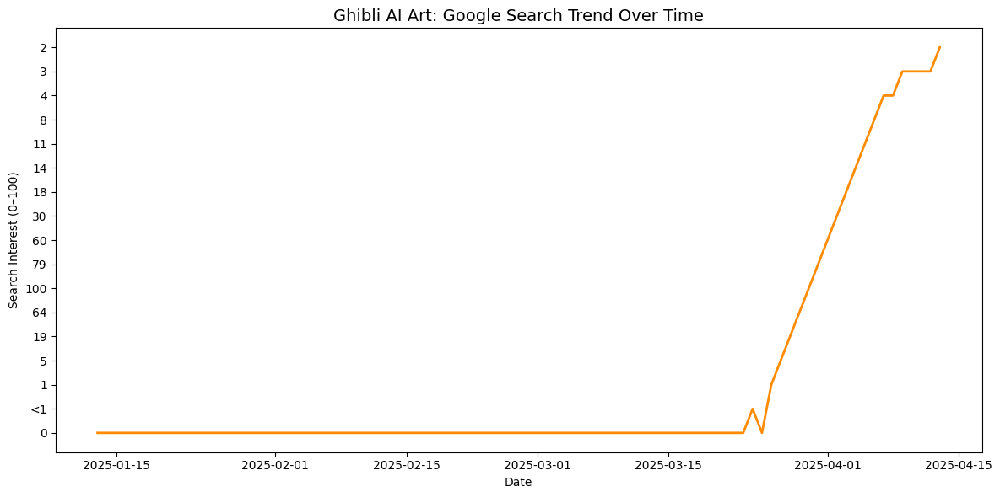

In [5]:
plt.figure(figsize=(12, 6))
plt.plot(df["Date"], df["Ghibli_AI"], color='darkorange', linewidth=2)

plt.title("Ghibli AI Art: Google Search Trend Over Time", fontsize=14)
plt.xlabel("Date")
plt.ylabel("Search Interest (0–100)")
plt.grid(False)
plt.tight_layout()
plt.show()


Now we visualize the trend in global interest for "Ghibli AI Art" from January to April 2025. 

To prepare for analysis, we clean the data by replacing any `<1` values in the `Ghibli_AI` column with `0` and convert the column to numeric format. We then identify the date with the highest search interest using `idxmax()` and mark this "viral spike" directly on the plot. 

The resulting line chart clearly highlights a dramatic spike in search interest on **March 30**, indicating the point at which Ghibli AI art gained significant global traction.

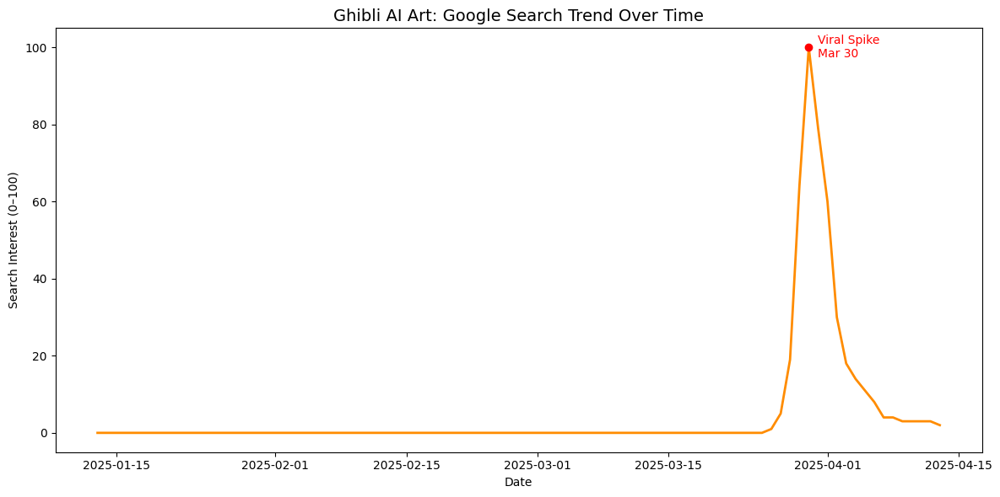

In [6]:
import matplotlib.pyplot as plt
import pandas as pd

# Convert '<1' to 0 and ensure Ghibli_AI is numeric
df["Ghibli_AI"] = df["Ghibli_AI"].replace("<1", "0").astype(float)

# Identify the peak
peak_idx = df["Ghibli_AI"].idxmax()
peak_date = df.loc[peak_idx, "Date"]
peak_value = df.loc[peak_idx, "Ghibli_AI"]

# Plot
plt.figure(figsize=(12, 6))
plt.plot(df["Date"], df["Ghibli_AI"], color='darkorange', linewidth=2)

# Mark the peak
plt.scatter(peak_date, peak_value, color='red', zorder=5)
plt.text(
    peak_date + pd.Timedelta(days=1),  # Shift right by 1 day
    peak_value,
    "Viral Spike\n" + peak_date.strftime('%b %d'),
    ha='left', va='center', fontsize=10, color='red'
)

# Labels and layout
plt.title("Ghibli AI Art: Google Search Trend Over Time", fontsize=14)
plt.xlabel("Date")
plt.ylabel("Search Interest (0–100)")
plt.grid(False)
plt.tight_layout()
plt.savefig("ghibli_google_trend_annotated.png", dpi=300)
plt.show()


---

# Part 2: Google Search Trends Analysis Over Regional Interest in "Ghibli AI Art"

This section explores how interest in **"Ghibli AI Art"** varied across different countries using data from **Google Trends**.  
The dataset provides a normalized score (0–100) for each country, representing relative search volume.

We will:
- Load the region-wise interest dataset  
- Clean the column names
- Visualize the data on an interactive **choropleth map** to highlight countries with higher engagement


### Loading and Cleaning Region-wise Interest Data

Here, we load region-specific Google Trends data to analyze how interest in "Ghibli AI Art" varies across countries. 

- The dataset is loaded from a CSV file containing interest percentages for three keywords: **Ghibli AI Art**, **Studio Ghibli AI Art**, and **Midjourney Ghibli**.


In [7]:
# Load region-wise interest data
region_df = pd.read_csv("ghibli_interest_by_region.csv", skiprows=1)

# Show the first few rows
region_df.head()

,Country,Ghibli AI Art: (1/13/25 - 4/13/25),Studio Ghibli AI Art: (1/13/25 - 4/13/25),Midjourney Ghibli: (1/13/25 - 4/13/25)
0,India,89%,9%,2%
1,Bangladesh,69%,27%,4%
2,Sri Lanka,81%,17%,2%
3,Nepal,83%,16%,1%
4,Pakistan,73%,27%,<1%


- We rename the first column to `"Country"` for clarity and extract the column that corresponds to "Ghibli AI Art" search interest.
- The percentage symbols are removed and the values are converted to floats.
- Rows with missing or null values are dropped to ensure clean analysis going forward.

This cleaned dataset allows us to compare Ghibli-related search popularity across different regions for the period **January 13 to April 13, 2025**.

In [8]:
# Rename the first column to 'Country' for clarity
region_df = region_df.rename(columns={region_df.columns[0]: "Country"})

# Automatically find the column containing "Ghibli AI Art"
interest_col = [col for col in region_df.columns if "Ghibli AI Art" in col][0]

# Clean and convert interest values
region_df["Ghibli_AI"] = region_df[interest_col].str.replace('%', '').astype(float)

# Drop rows with missing values
region_df = region_df.dropna(subset=["Ghibli_AI"])

# Check the cleaned data
region_df.head()


,Country,Ghibli AI Art: (1/13/25 - 4/13/25),Studio Ghibli AI Art: (1/13/25 - 4/13/25),Midjourney Ghibli: (1/13/25 - 4/13/25),Ghibli_AI
0,India,89%,9%,2%,89.0
1,Bangladesh,69%,27%,4%,69.0
2,Sri Lanka,81%,17%,2%,81.0
3,Nepal,83%,16%,1%,83.0
4,Pakistan,73%,27%,<1%,73.0


## Choropleth Map of Ghibli AI Art Interest by Country

This visualization displays the global distribution of search interest in **"Ghibli AI Art"** using Google Trends data.  
The values are normalized on a scale from 0 to 100, where 100 indicates the region with the highest relative search volume.

We use a choropleth map to highlight the countries where the trend gained the most traction between **January and April 2025**.

The color intensity reflects the level of interest — deeper colors represent higher engagement.


In [9]:
import folium
import geopandas as gpd

# 1. Load the shapefile
shapefile_path = "World_Countries_Generalized/World_Countries_Generalized.shp"
world_geo = gpd.read_file(shapefile_path)

# 2. Check column names to match with 'Country'
print(world_geo.columns)


Index(['COUNTRY', 'ISO', 'COUNTRYAFF', 'AFF_ISO', 'geometry'], dtype='object')


In [10]:
# Merge your region_df (interest data) with shapefile on country names
merged = world_geo.merge(region_df, how="left", left_on="COUNTRY", right_on="Country")

# Fill NaNs with 0 so white regions are treated as zero interest
merged["Ghibli_AI"] = merged["Ghibli_AI"].fillna(0)

# Create a base map
m = folium.Map(location=[20, 0], zoom_start=2, tiles="cartodbpositron")

# Add choropleth layer
folium.Choropleth(
    geo_data=merged,
    name="Ghibli AI Interest",
    data=merged,
    columns=["COUNTRY", "Ghibli_AI"],
    key_on="feature.properties.COUNTRY",
    fill_color="YlGnBu",
    fill_opacity=0.9,
    line_opacity=0.3,
    threshold_scale=[0, 20, 40, 60, 80, 100],
    legend_name="Ghibli AI Art Interest (%)",
    highlight=True,
).add_to(m)

# Add static country labels
from folium.features import DivIcon
for _, row in merged.iterrows():
    if row["Ghibli_AI"] > 0:  # Only label countries with interest
        centroid = row["geometry"].centroid
        folium.map.Marker(
            [centroid.y, centroid.x],
            icon=DivIcon(
                icon_size=(150, 10),
                icon_anchor=(0, 0),
                html=f'<div style="font-size:8pt; color:black;"><b>{row["COUNTRY"]}</b></div>',
            )
        ).add_to(m)

# Add hover tooltip
folium.GeoJson(
    merged,
    name="Hover Info",
    style_function=lambda x: {"fillColor": "#00000000", "color": "#00000000"},
    tooltip=folium.GeoJsonTooltip(fields=["COUNTRY", "Ghibli_AI"],
                                   aliases=["Country", "Interest (%)"],
                                   localize=True)
).add_to(m)

# Add map title
title_html = '''
     <h3 align="center" style="font-size:18px"><b>Global Interest in Ghibli AI Art (Jan 13 – Apr 13, 2025)</b></h3>
     '''
m.get_root().html.add_child(folium.Element(title_html))
m.save("ghibli_interest_map.html")


# Display map
m

### Exporting Map as an Image (Automated Screenshot)

This section uses **Selenium** and **Pillow (PIL)** to automate the process of capturing a screenshot of an interactive HTML map:

- **Headless Chrome Browser Setup**: Chrome runs in headless mode using `ChromeOptions` for a full-size window.
- **WebDriver Configuration**: `ChromeDriverManager` sets up the appropriate ChromeDriver version automatically.
- **Load HTML Map**: The local HTML file `ghibli_interest_map.html` is opened using Selenium.
- **Wait and Screenshot**: A short delay ensures the map is fully loaded before capturing the screenshot using `driver.save_screenshot`.
- **View Output**: The screenshot (`ghibli_interest_map.png`) is optionally opened using the `PIL.Image` module.

This helps preserve visualizations for reports or presentations without needing to open the map manually.

In [11]:
# pip install selenium
# !pip install webdriver-manager
# !pip install PIL


In [12]:
from selenium import webdriver
from selenium.webdriver.chrome.service import Service
from webdriver_manager.chrome import ChromeDriverManager
from PIL import Image
import time
import os

# 1. Set up Chrome options
options = webdriver.ChromeOptions()
options.add_argument("--headless")
options.add_argument("--window-size=1920,1080")

# 2. Set up ChromeDriver service correctly
service = Service(ChromeDriverManager().install())
driver = webdriver.Chrome(service=service, options=options)

# 3. Load your HTML map file
map_path = os.path.abspath("ghibli_interest_map.html")
driver.get("file://" + map_path)

# 4. Wait for map to load (can increase time if internet is slow)
time.sleep(3)

# 5. Save screenshot
driver.save_screenshot("ghibli_interest_map.png")
driver.quit()

# 6. Optional: Open the image
Image.open("ghibli_interest_map.png").show()


### Cleaning Additional Trend Columns: Studio Ghibli & Midjourney

In this step, we clean and convert the remaining columns:
- **Studio Ghibli AI Art**
- **Midjourney Ghibli**

These columns also contain interest values as percentages, which need to be stripped and converted to numeric format.  
This will allow us to compare **all three Ghibli-related search trends** across different countries in the next visualization.


In [13]:
# Auto-detect columns by partial name
studio_col = [col for col in region_df.columns if "Studio Ghibli AI Art" in col][0]
midjourney_col = [col for col in region_df.columns if "Midjourney Ghibli" in col][0]

# Clean Studio Ghibli column (no "<1" issue reported)
region_df["Studio_Ghibli_AI"] = region_df[studio_col].str.replace('%', '').astype(float)

# Clean Midjourney column: Replace '<1' with '0.5' before conversion
region_df["Midjourney_Ghibli"] = (
    region_df[midjourney_col]
    .str.replace('<1', '0.5')             # Replace <1 with 0.5
    .str.replace('%', '')                 # Remove percentage
    .astype(float)                        # Convert to float
)

# Preview cleaned data
region_df.head()

,Country,Ghibli AI Art: (1/13/25 - 4/13/25),Studio Ghibli AI Art: (1/13/25 - 4/13/25),Midjourney Ghibli: (1/13/25 - 4/13/25),Ghibli_AI,Studio_Ghibli_AI,Midjourney_Ghibli
0,India,89%,9%,2%,89.0,9.0,2.0
1,Bangladesh,69%,27%,4%,69.0,27.0,4.0
2,Sri Lanka,81%,17%,2%,81.0,17.0,2.0
3,Nepal,83%,16%,1%,83.0,16.0,1.0
4,Pakistan,73%,27%,<1%,73.0,27.0,0.5


### Top 10 Countries by Ghibli-Related Search Interest

This part visualizes country-wise interest in Ghibli-related AI content from January 1 to April 13, 2025. The top 10 countries are selected based on overall search interest for the term `Ghibli_AI`.

The data is reshaped into a long format to allow comparison across three categories:
- **Ghibli_AI**
- **Studio_Ghibli_AI**
- **Midjourney_Ghibli**

A grouped bar chart is created using Seaborn to highlight how different keywords trended across countries. This helps identify regional variations in interest across related Ghibli topics.

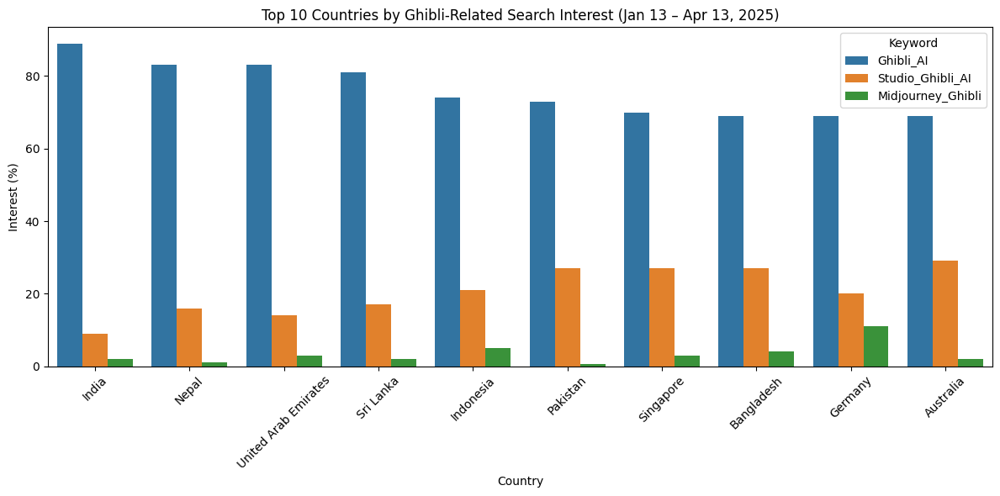

In [14]:
import matplotlib.pyplot as plt
import seaborn as sns

# 1. Sort by Ghibli_AI and select top 10
top10 = region_df.sort_values(by="Ghibli_AI", ascending=False).head(10)

# 2. Reshape the data for grouped bar chart
bar_data = top10[["Country", "Ghibli_AI", "Studio_Ghibli_AI", "Midjourney_Ghibli"]]
bar_data = bar_data.melt(id_vars="Country", var_name="Keyword", value_name="Interest (%)")

# 3. Plot
plt.figure(figsize=(12, 6))
sns.barplot(data=bar_data, x="Country", y="Interest (%)", hue="Keyword")
plt.title("Top 10 Countries by Ghibli-Related Search Interest (Jan 13 – Apr 13, 2025)")
plt.xticks(rotation=45)
plt.tight_layout()
# Save figure
plt.savefig("top10_ghibli_interest_by_country.png", dpi=300)
plt.show()


### Heatmap of Ghibli-Related Interest by Country

This is a heatmap illustrating how search interest varied across countries for three Ghibli-related topics between January 13 and April 13, 2025:

- **Ghibli_AI**
- **Studio_Ghibli_AI**
- **Midjourney_Ghibli**

Each row corresponds to a country and each column to a keyword, with the intensity of color representing the level of interest. The values are annotated directly within each cell for clear comparison.

This heatmap enables a quick visual assessment of regional trends and highlights which countries demonstrated the highest interest in different aspects of Ghibli AI art.


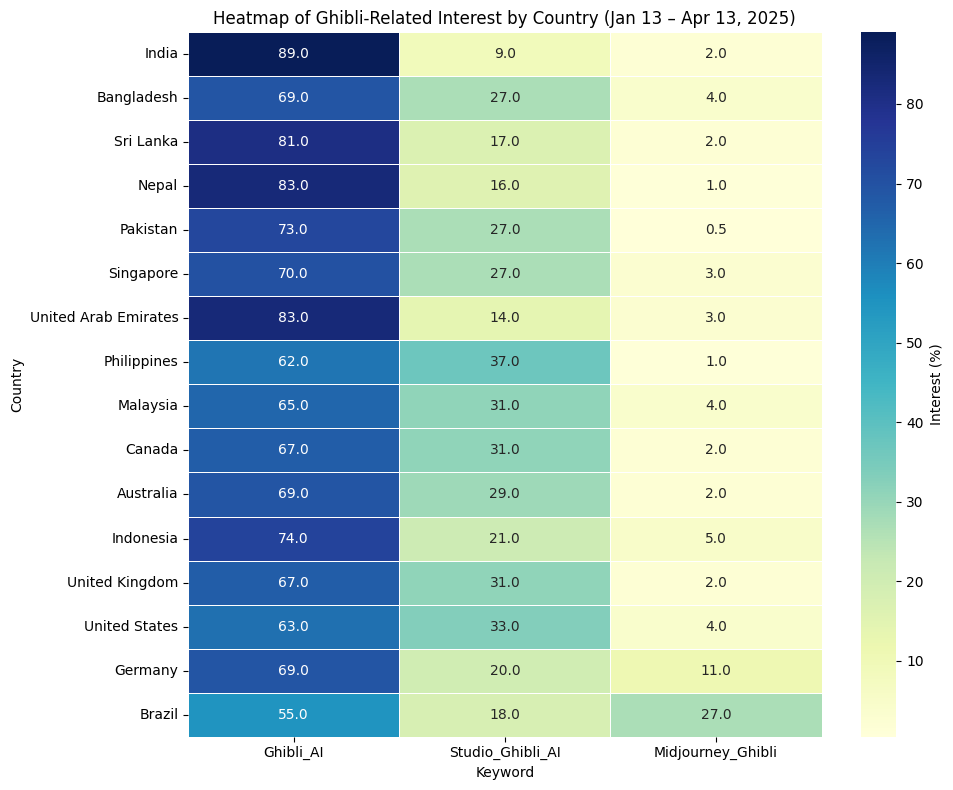

In [15]:
# 1. Select relevant data
heatmap_data = region_df.set_index("Country")[["Ghibli_AI", "Studio_Ghibli_AI", "Midjourney_Ghibli"]]

# 2. Plot heatmap
plt.figure(figsize=(10, 8))
sns.heatmap(heatmap_data, annot=True, cmap="YlGnBu", fmt=".1f", linewidths=0.5, cbar_kws={'label': 'Interest (%)'})
plt.title("Heatmap of Ghibli-Related Interest by Country (Jan 13 – Apr 13, 2025)")
plt.xlabel("Keyword")
plt.ylabel("Country")
plt.tight_layout()
# Save figure
plt.savefig("ghibli_interest_by_country.png", dpi=300)
plt.show()


### Heatmap of Top 10 Countries by Ghibli AI Interest

This heatmap focuses on the **top 10 countries** with the highest interest in **Ghibli AI** from January 13 to April 13, 2025.

The color intensity represents the percentage of interest, making it easy to visually assess how interest varied across different countries and trends. This visualization helps highlight regional popularity patterns and identify countries where each specific Ghibli-related trend was most prominent.


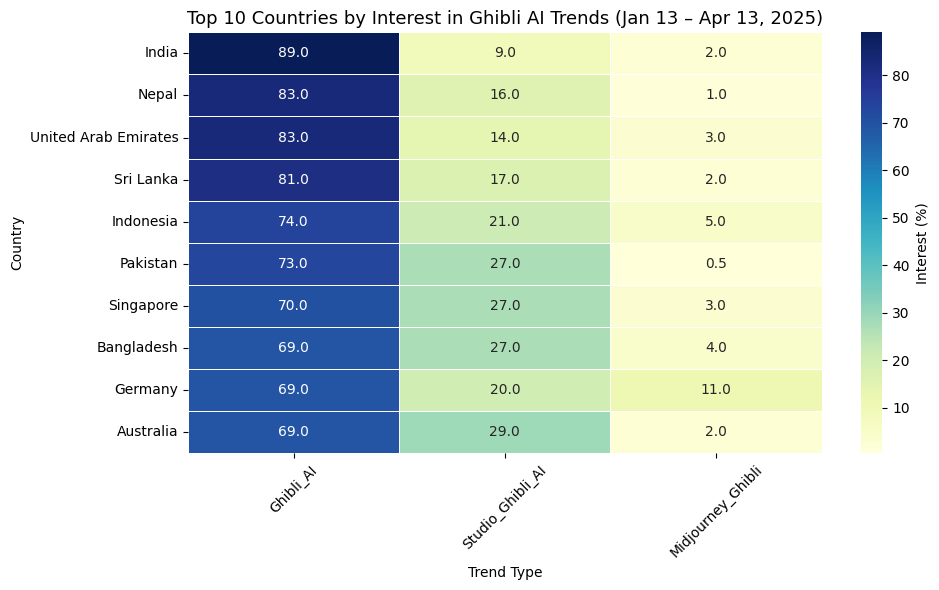

In [16]:
import seaborn as sns
import matplotlib.pyplot as plt

# Select relevant columns and drop NaNs
heatmap_data = region_df[["Country", "Ghibli_AI", "Studio_Ghibli_AI", "Midjourney_Ghibli"]].dropna()

# Sort by Ghibli_AI and select top 10
top_countries = heatmap_data.sort_values(by="Ghibli_AI", ascending=False).head(10)

# Set 'Country' as index
top_countries.set_index("Country", inplace=True)

# Plot heatmap
plt.figure(figsize=(10, 6))
sns.heatmap(top_countries, annot=True, fmt=".1f", cmap="YlGnBu", linewidths=0.5, cbar_kws={'label': 'Interest (%)'})
plt.title("Top 10 Countries by Interest in Ghibli AI Trends (Jan 13 – Apr 13, 2025)", fontsize=13)
plt.ylabel("Country")
plt.xlabel("Trend Type")
plt.xticks(rotation=45)
plt.tight_layout()
# Save figure
plt.savefig("top10_ghibli_interest_by_country_htmp.png", dpi=300)
plt.show()


# Part 3: Community Engagement and Sentiment Analysis Using Reddit Data

This final section analyzes how the **Ghibli AI Art** trend was received across online communities using data from **Reddit**.

Using the `praw` API, we extract the top 100 Reddit posts that mention “ghibli ai” between **March 25 and April 13, 2025** — the same window during which the trend peaked on Google Search.

We will:

- Collect Reddit posts and store relevant metadata (title, author, subreddit, score, comments, date, and URL)
- Analyze engagement trends such as post frequency and popularity
- Perform **sentiment analysis** on post titles (positive, neutral, negative)
- Visualize trends to understand user response and perception

Together, these analyses offer a deeper, people-centered view of how the trend was discussed and perceived on social media — complementing the search behavior insights from Parts 1 and 2.


### Loading and Filtering Reddit Posts

We use the `praw` API to connect to Reddit and fetch the top 100 posts containing the term **"ghibli ai"** between **March 25 and April 13, 2025**. Each post's metadata—including title, author, subreddit, score, comment count, timestamp, and URL—is stored for further analysis.

This dataset provides insight into community engagement levels during the period when the Ghibli AI Art trend spiked in popularity.

In [17]:
# !pip install praw
# !pip install vaderSentiment
# !pip install seaborn


[notice] A new release of pip is available: 24.3.1 -> 25.0.1
[notice] To update, run: C:\Users\brund\AppData\Local\Programs\Python\Python312\python.exe -m pip install --upgrade pip



[notice] A new release of pip is available: 24.3.1 -> 25.0.1
[notice] To update, run: C:\Users\brund\AppData\Local\Programs\Python\Python312\python.exe -m pip install --upgrade pip



[notice] A new release of pip is available: 24.3.1 -> 25.0.1
[notice] To update, run: C:\Users\brund\AppData\Local\Programs\Python\Python312\python.exe -m pip install --upgrade pip


In [18]:
import praw
import pandas as pd
from datetime import datetime

reddit = praw.Reddit(
    client_id="Z9BrlOZvp14huXwRuTMxUw",          # Replace with your actual values
    client_secret="VGL2ovLi4h6IYkvXY8L7REbXZ2v2ig",
    user_agent="ghibli-project by u/WonderfulScholar6655",
    username="WonderfulScholar6655",
    password="ghibliproject"
)

# We'll use Reddit's search and filter later by date
query = "ghibli ai"
subreddit = reddit.subreddit("all")

# Pull top 100 posts matching the query
posts = []
for post in subreddit.search(query, sort="top", limit=100):
    post_date = datetime.utcfromtimestamp(post.created_utc)
    if datetime(2025, 3, 25) <= post_date <= datetime(2025, 4, 13):
        posts.append({
            "title": post.title,
            "author": str(post.author),
            "subreddit": post.subreddit.display_name,
            "score": post.score,
            "num_comments": post.num_comments,
            "created_utc": post_date.strftime('%Y-%m-%d %H:%M:%S'),
            "url": post.url
        })

# Convert to DataFrame
reddit_df = pd.DataFrame(posts)
reddit_df.head()

C:\Users\brund\AppData\Local\Temp\ipykernel_46000\2463662765.py:20: DeprecationWarning: datetime.datetime.utcfromtimestamp() is deprecated and scheduled for removal in a future version. Use timezone-aware objects to represent datetimes in UTC: datetime.datetime.fromtimestamp(timestamp, datetime.UTC).
  post_date = datetime.utcfromtimestamp(post.created_utc)


,title,author,subreddit,score,num_comments,created_utc,url
0,Please make it stop,JustSomeRandomDude02,memes,93285,2138,2025-03-29 02:27:09,https://i.redd.it/vv1hvfdvhjre1.jpeg
1,Zelda Williams on her Instagram story,captainzaro,ghibli,72779,2159,2025-03-27 21:29:32,https://i.redd.it/qxxjtl1vvare1.jpeg
2,This Studio Ghibli AI trend is an utter insult...,Funendra,movies,34841,5258,2025-03-29 09:27:56,https://www.reddit.com/r/movies/comments/1jmik...
3,AI is awful actually,Rabbitheadz,webcomics,21001,671,2025-04-02 09:50:33,https://i.redd.it/3vjyx2oh8ese1.jpeg
4,He's crying now thanks,Excellent-Guess-3456,shitposting,18459,119,2025-04-01 09:39:38,https://i.redd.it/4tni0ogr17se1.jpeg


### Visualizing Top Reddit Posts by Comment Count

To understand which posts sparked the most conversation around the "Ghibli AI" trend, we sort the collected Reddit data by the number of comments and select the top 10 most discussed posts.

We then create a horizontal bar chart to visualize these posts, helping identify content that generated the highest levels of engagement within the community.

C:\Users\brund\AppData\Local\Temp\ipykernel_46000\2454803570.py:15: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  barplot = sns.barplot(
C:\Users\brund\AppData\Local\Temp\ipykernel_46000\2454803570.py:15: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  barplot = sns.barplot(


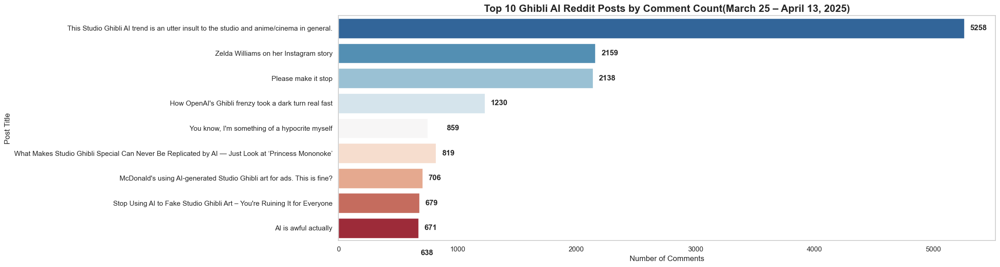

In [19]:
import seaborn as sns
import matplotlib.pyplot as plt
import pandas as pd

# Sort and prepare the top 10 posts
top_comments_df = reddit_df.sort_values(by="num_comments", ascending=False).head(10)

# Set style
sns.set(style="whitegrid")

# Set figure size
plt.figure(figsize=(22, 6))  # Wider plot

# Plot horizontal bar chart with gradient palette
barplot = sns.barplot(
    data=top_comments_df,
    y="title",
    x="num_comments",
    palette="RdBu_r",
    ci=None 
)

plt.grid(False)

# Add data labels
for i, value in enumerate(top_comments_df["num_comments"]):
    plt.text(value + 50, i, f'{value}', va='center', fontweight='bold')

# Titles and labels
plt.title("Top 10 Ghibli AI Reddit Posts by Comment Count(March 25 – April 13, 2025)", fontsize=16, weight='bold')
plt.xlabel("Number of Comments", fontsize=12)
plt.ylabel("Post Title", fontsize=12)

# Clean layout
plt.tight_layout()
# Save & Show
plt.savefig("ghibli_top_comments_plot.png", dpi=300)
plt.show()

### Daily Reddit Post Activity for "Ghibli AI"

This interactive line chart visualizes the number of Reddit posts mentioning "Ghibli AI" over time between March 25 and April 13, 2025. By grouping posts by date, this plot helps highlight daily engagement trends and the specific days where discussion spiked within the Reddit community.

In [20]:
import plotly.express as px

# Prepare data
reddit_df["created_utc"] = pd.to_datetime(reddit_df["created_utc"])
daily_counts = reddit_df.groupby(reddit_df["created_utc"].dt.date).size().reset_index(name='Post Count')
daily_counts.columns = ['Date', 'Post Count']

# Create interactive modern line chart
fig = px.line(
    daily_counts,
    x='Date',
    y='Post Count',
    text='Post Count',
    title="Daily Reddit Posts about Ghibli AI<br><span style='font-size:14px'>(March 25 – April 13, 2025)</span>",
    markers=True,
)

# Update layout for a modern look
fig.update_traces(line=dict(width=3, color='#2a9d8f'), marker=dict(size=8, color='#264653'), textposition="top center")

fig.update_layout(
    template="simple_white",
    title_font=dict(size=20, family="Arial", color="#264653"),
    xaxis_title=None,
    yaxis_title="Number of Posts",
    font=dict(size=14, color="#333"),
    hovermode="x unified",
    margin=dict(l=40, r=40, t=70, b=40),
)

fig.update_yaxes(gridcolor='rgba(0,0,0,0.05)')
fig.update_xaxes(showgrid=False)
fig.show()


In [21]:
import plotly.express as px

# --- Prepare Data with Titles Grouped Per Day ---
reddit_df["created_utc"] = pd.to_datetime(reddit_df["created_utc"])
reddit_df["date"] = reddit_df["created_utc"].dt.date

# Group posts and create a summary of post titles per date
grouped = reddit_df.groupby("date").agg(
    post_count=("title", "count"),
    titles=("title", lambda x: "<br>".join(x[:5]))  # show top 5 titles
).reset_index()

grouped.columns = ['Date', 'Post Count', 'Sample Titles']

# --- Create the Plotly Line Chart ---
fig = px.line(
    grouped,
    x="Date",
    y="Post Count",
    text="Post Count",
    title="Daily Reddit Posts about Ghibli AI<br><span style='font-size:14px'>(March 25 – April 13, 2025)</span>",
    markers=True,
    hover_data={"Sample Titles": True, "Date": False, "Post Count": False}
)

# --- Customize Appearance ---
fig.update_traces(
    line=dict(width=3, color='#2a9d8f'),
    marker=dict(size=8, color='#264653'),
    textposition="top center",
    hovertemplate="<b>Date</b>: %{x}<br><b>Posts</b>: %{y}<br><br><b>Sample Titles</b>:<br>%{customdata[0]}"
)

fig.update_layout(
    template="simple_white",
    title_font=dict(size=20, family="Arial", color="#264653"),
    xaxis_title=None,
    yaxis_title="Number of Posts",
    font=dict(size=14, color="#333"),
    hovermode="x unified",
    margin=dict(l=40, r=40, t=70, b=40),
    xaxis=dict(
        rangeslider=dict(visible=True),
        type="date",
        showgrid=False
    ),
    yaxis=dict(gridcolor='rgba(0,0,0,0.05)')
)

fig.show()


---

### Sentiment Analysis of Reddit Posts

In this step, we analyze the **tone and emotional sentiment** behind Reddit post titles that mention **Ghibli AI**.

We use the **VADER sentiment analyzer**, which is specifically designed for analyzing social media content like Reddit, tweets, and reviews.

#### What is VADER?
VADER (Valence Aware Dictionary and sEntiment Reasoner) is a rule-based sentiment analysis tool that returns a **compound score** between -1 (most negative) and +1 (most positive), along with individual scores for:
- Positive
- Neutral
- Negative

####  Goal:
- Compute a sentiment score for each post title.
- Classify the sentiment as **Positive**, **Neutral**, or **Negative**.
- Visualize how the community reacted emotionally to the Ghibli AI trend during its viral period.

This analysis gives us a sense of whether the viral buzz was driven by **enthusiasm**, **criticism**, or **mixed feelings**.



To understand how Reddit users emotionally responded to the Ghibli AI trend, we perform sentiment analysis on post titles using the VADER sentiment analyzer. Each title is assigned a compound sentiment score and classified into one of three categories:

- **Positive** (score ≥ 0.05)
- **Negative** (score ≤ -0.05)
- **Neutral** (otherwise)

This classification allows us to measure the general tone of the discussion and examine how public sentiment aligns with spikes in engagement and interest.



In [22]:
from vaderSentiment.vaderSentiment import SentimentIntensityAnalyzer

# Initialize the analyzer
analyzer = SentimentIntensityAnalyzer()

# Function to classify compound score
def classify_sentiment(score):
    if score >= 0.05:
        return "Positive"
    elif score <= -0.05:
        return "Negative"
    else:
        return "Neutral"

# Apply sentiment analysis to each title
reddit_df["sentiment_score"] = reddit_df["title"].apply(lambda x: analyzer.polarity_scores(x)["compound"])
reddit_df["sentiment_label"] = reddit_df["sentiment_score"].apply(classify_sentiment)

# Preview
reddit_df[["title", "sentiment_score", "sentiment_label"]].head()

display(reddit_df[["title", "sentiment_score", "sentiment_label"]])


,title,sentiment_score,sentiment_label
0,Please make it stop,0.0258,Neutral
1,Zelda Williams on her Instagram story,0.0000,Neutral
2,This Studio Ghibli AI trend is an utter insult...,-0.5563,Negative
3,AI is awful actually,-0.4588,Negative
4,He's crying now thanks,-0.0516,Negative
...,...,...,...
79,KH1 Sora in Studio Ghibli Style,0.0000,Neutral
80,Just say you’re jealous of your brother Shad J...,-0.4588,Negative
81,The only legit Ghibli AI-Meme,0.0000,Neutral
82,Warlock Girls,0.0000,Neutral


### Visualizing Sentiment Distribution with a Donut Chart

To summarize the overall emotional tone of Reddit posts mentioning "Ghibli AI," we visualize the sentiment classification results using a donut chart. The chart displays the proportion of posts labeled as **Positive**, **Neutral**, and **Negative**, based on the sentiment analysis performed on post titles.

We use color-coded segments to clearly distinguish between sentiment categories, providing an at-a-glance understanding of how users responded emotionally to the trend between March 25 and April 13, 2025.

In [23]:
import pandas as pd
import plotly.express as px

# Sample sentiment data
sentiment_counts = reddit_df["sentiment_label"].value_counts().reset_index()
sentiment_counts.columns = ["Sentiment", "Count"]

# Define your color map
color_map = {
    "Positive": "#2ca02c",  # green
    "Neutral": "#1f77b4",   # blue
    "Negative": "#d62728"   # red
}

# Convert to datetime just in case
reddit_df["created_utc"] = pd.to_datetime(reddit_df["created_utc"])

# Extract min and max dates for the title
start_date = reddit_df["created_utc"].min().strftime('%b %d')
end_date = reddit_df["created_utc"].max().strftime('%b %d, %Y')

# Create donut chart
fig = px.pie(
    sentiment_counts,
    names="Sentiment",
    values="Count",
    hole=0.5,
    color="Sentiment",
    color_discrete_map=color_map
)

# Customize hover label and template
fig.update_traces(
    hovertemplate="<b>%{label}</b><br>Posts: %{value}<br>Share: %{percent}",
    textinfo="percent+label"
)

# Update layout with hover style and dynamic title
fig.update_layout(
    hoverlabel=dict(
        bgcolor="white",
        font_size=13,
        font_family="Arial",
        font_color="black",
        bordercolor="lightgray"
    ),
    title_text=f"Distribution of Sentiments in Reddit Titles<br><sup>({start_date} – {end_date})</sup>",
    title_x=0.5
)

fig.show()


C:\Users\brund\AppData\Local\Temp\ipykernel_46000\964072484.py:18: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




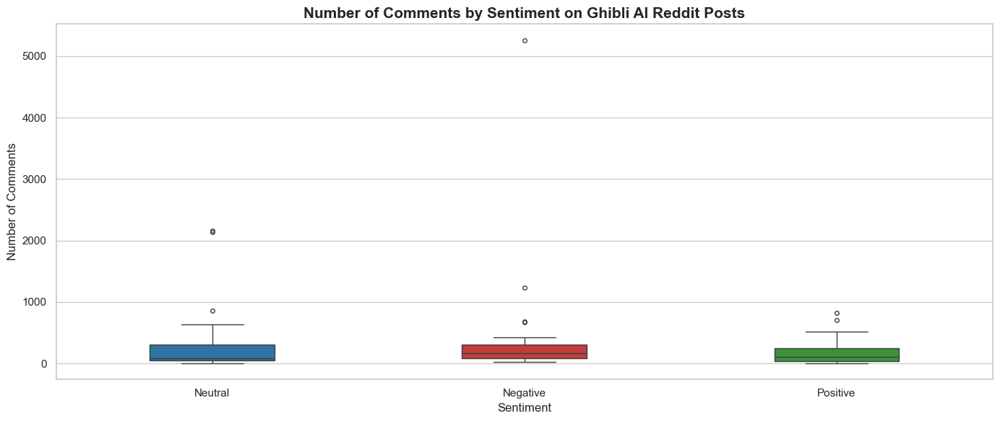

In [24]:
import seaborn as sns
import matplotlib.pyplot as plt

# Set seaborn style for cleaner visuals
sns.set(style="whitegrid")

# Define color palette for sentiments
color_map = {
    "Positive": "#2ca02c",  # green
    "Neutral": "#1f77b4",   # blue
    "Negative": "#d62728"   # red
}

# Set figure size with more width for spacing
plt.figure(figsize=(14, 6))  # Wider plot for clarity

# Plot boxplot
ax = sns.boxplot(
    data=reddit_df,
    x="sentiment_label",
    y="num_comments",
    palette=color_map,
    order=["Neutral", "Negative", "Positive"],
    width=0.4,  # slightly narrower boxes for spacing
    fliersize=4  # control outlier marker size
)

# Title and labels
ax.set_title("Number of Comments by Sentiment on Ghibli AI Reddit Posts", fontsize=15, fontweight='bold')
ax.set_xlabel("Sentiment", fontsize=12)
ax.set_ylabel("Number of Comments", fontsize=12)

# Increase spacing in layout
plt.tight_layout()

# Show the plot
plt.show()


---

# Interpretation & Insights

## Google Search Trend (Jan 13 – Apr 13, 2025)
- Interest in "Ghibli AI Art" showed steady growth from late March and spiked on **March 30, 2025**, clearly marking the day it went viral.
- The search interest hit the peak value of 100, confirming a global surge in curiosity or controversy about Ghibli-style AI-generated art.

## Top Countries by Interest (Google Trends)
- Countries with the highest search interest were **India**, **Nepal**, and **United Arab Emirates**, followed by other countries.
- All three keyword categories – "Ghibli AI", "Studio Ghibli AI Art", and "Midjourney Ghibli" – saw significant overlap in these top countries.
- This suggests strong enthusiasm and engagement from Southeast Asian communities in particular.

## Reddit Post Activity (Mar 25 – Apr 13, 2025)
- Daily post activity increased sharply around the viral spike, aligning closely with Google search behavior.
- The **peak in Reddit posts occurred on March 29**, just 3 days after the Google Trends spike, showing how quickly the conversation spread.

## Top Reddit Posts by Engagement
- Posts with the most comments often expressed **concerns about AI art ethics** or **nostalgic connections** to Ghibli.
- Controversial or emotionally-charged titles like *“This Studio Ghibli AI trend is an utter insult...”* received disproportionately higher engagement.

## Sentiment Analysis
- The overall sentiment of Reddit post titles was **mostly neutral**, but **negative sentiment posts received higher comment counts on average**, indicating controversy fuels discussion.
- Positive posts were fewer but still generated strong support from parts of the community that found the AI art impressive or nostalgic.

## Summary
- The Ghibli AI trend wasn't just a moment of artistic novelty — it sparked a complex mix of admiration, backlash, and ethical debate.
- Social media engagement mirrored public interest, with spikes in search and post frequency tightly aligned.
- Southeast Asia emerged as a geographic hotbed of interest, suggesting potential cultural resonance with the art style or themes.

